# 17 - Model Interpretation

- This chapter is about explainable models or explainable AI. Not causality.
- Demonstrates
    - Running a Logistic Regression (which is more interpretable)
    - Running a Decision Tree
    - Looking at Feature Importance
    - Building a Surrogate Model
        - A surrogate model is a (typically simple) model that is fit to another (more complicated) model's preditions.
        - So, you can explain how your model is predicting (rather than explain the underlying data)
        - Note, the author actually fit a *regression tree* as the surrogate model
        - Note, the author claims you get an indication of *nonlinearities* in a regression when a feature follows itself!
            - Like, splitting on r then again splitting on r again right below.
            - But, this is an indication of a non-constant relationship rather than a non-linear relationship
            - Indeed, a perfect linear relationship would have infinite splits. A random forest will do a much worse job of capturing a linear relationship than a linear regression (as you would expect.)
                - B/c A random forest regressor predicts bins of outcomes.

In [1]:
from setup import * #gets the real data

/media/ryan/5e52f95b-dbda-4605-bec6-10d513d58772/GitHubProjExt/effective-xgboost-notes/setup.py:32: DtypeWarning: Columns (0,2,8,10,21,23,24,25,26,27,28,42,44,54,56,64,81,83,85,87,105,107,109,121,123,125,148,150,157,172,174,192,194,210,218,219,221,223,246,247,249,262,264,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,302,304,306,325,326,329,341,368,371,384,385,389,390,391,393,394) have mixed types. Specify dtype option on import or set low_memory=False.
  kag = pd.read_csv(z.open(member_name))
/media/ryan/5e52f95b-dbda-4605-bec6-10d513d58772/GitHubProjExt/effective-xgboost-notes/setup.py:49: FutureWarning: Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  education=df_.Q4.replace({'Master’s degree': 18,
/media/ryan/5e52f95b-dbda-4605-bec6-10d513d58772/GitHubProjEx

In [2]:
import numpy as np
import numpy.random as rn
import pandas as pd
import matplotlib.pyplot as plt
from sklearn import tree, dummy, preprocessing, ensemble, linear_model
import xgboost as xgb
import dtreeviz
from yellowbrick.model_selection import validation_curve
#also, must install graphviz for plotting to work with xgb

## 17.1 Logistic Model

- For a logistic model, scaling the variables may make interpretation of the coefficients easier
    - But still, you should be careful in interpreting discrete variables' coefficients vs continuous variables' coefficients

In [4]:
std = preprocessing.StandardScaler()
lr = linear_model.LogisticRegression(penalty=None)
lr.fit(std.fit_transform(X_train), y_train)
lr.score(std.transform(X_test), y_test) #just a logistic regression does surprisingly well! Decision tree doesn't do much better.

0.7337016574585635

In [5]:
lr.coef_

array([[-1.58733218e-01, -4.02762603e-01,  6.06020789e-01,
        -1.46514219e-01, -8.11865373e-02, -6.05761218e-01,
         3.17376820e-02,  3.15445682e-02, -3.13904583e-02,
        -5.25363133e-04, -7.98681407e-03, -5.20331959e-02,
        -5.25142316e-03,  1.01878455e-01,  3.50116394e-01,
        -1.79338226e-01,  2.44223894e-02, -3.38681943e-01]])

<Axes: >

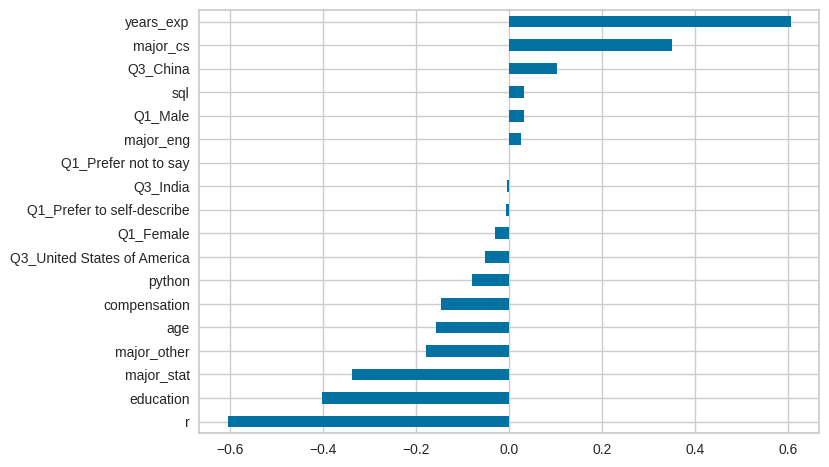

In [8]:
(pd.Series(lr.coef_[0], index=X_train.columns)
    .sort_values()
    .plot.barh()
)

<Axes: >

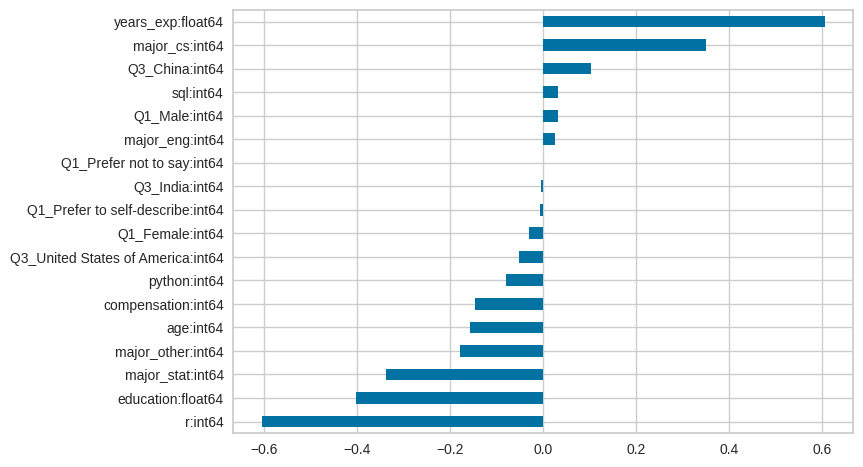

In [21]:
(pd.Series(lr.coef_[0], index=(X_train.columns + ":" + X_train.dtypes.values.astype(str)))
    .sort_values()
    .plot.barh()
)

## 17.2 Decision Tree Model

- You can look at the plot
- You can also do feature importance for a single tree

<Axes: >

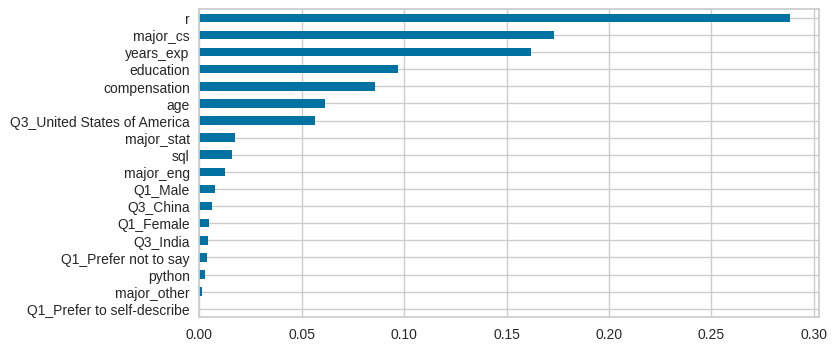

In [22]:
tree7 = tree.DecisionTreeClassifier(max_depth=7)
tree7.fit(X_train, y_train)
tree7.score(X_test, y_test)
fig, ax = plt.subplots(figsize=(8,4))
(
    pd.Series(tree7.feature_importances_, index=X_train.columns)
    .sort_values()
    .plot.barh(ax=ax)
)

findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font f

findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font f

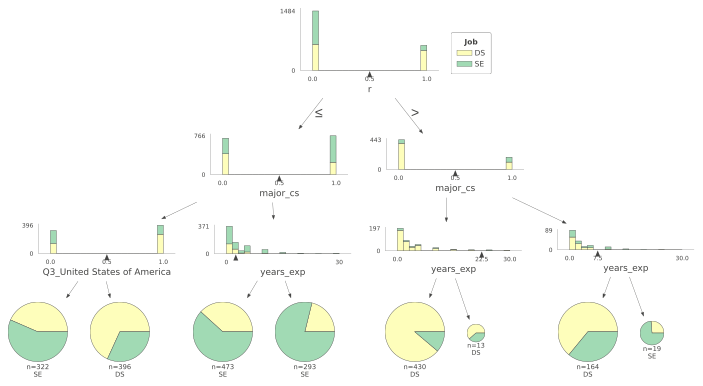

In [24]:
dt3 = tree.DecisionTreeClassifier(max_depth=3)
dt3.fit(X_train, y_train)
viz = dtreeviz.model(dt3, X_train=X_train, y_train=y_train, feature_names=list(X_train.columns), \
                     target_name='Job', class_names=['DS', 'SE'])
viz.view()

## 17.3 Feature Importance for XGBoost

- For XGBoost, feature importance is the normalized gain across all the trees *where the feature is used*
    - So, they don't see the importance when it isn't picked. Which, i feel may overstate its value.
    - Or, maybe the author missed the details? He has missed some before...
- Note, feature importance may be useful for two categories, but not for multi-class
    - For multiclass problems, SHAP values may be the best way to determine feature importance for recommendations
- Feature importance can be calculated in (at least) 3 ways
    1. using 'gain': this is calculated as the total gain in the model's performance that results from using a feature
            - so, reduction in loss?
            - **this is the default**
    2. weight: # of times a feature is used in the model
        - ? like, number of trees
    3. cover: # of samples that are affected by a feature
        - 
- The three give fairly different answers!
    - I would say gain makes the most sense.

<Axes: >

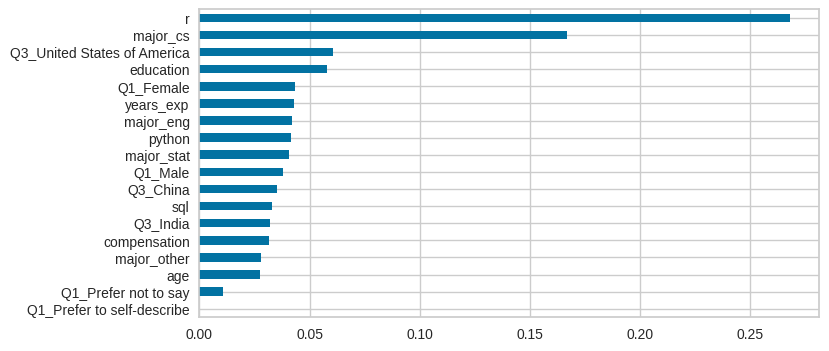

In [28]:
xgb_def = xgb.XGBClassifier()
xgb_def.fit(X_train, y_train)

# plotting with default feature_importances, **weight**
fig, ax = plt.subplots(figsize=(8,4))
(pd.Series(xgb_def.feature_importances_, index=X_train.columns)
.sort_values()
.plot.barh(ax=ax)
)

<Axes: title={'center': 'Feature importance'}, xlabel='F score', ylabel='Features'>

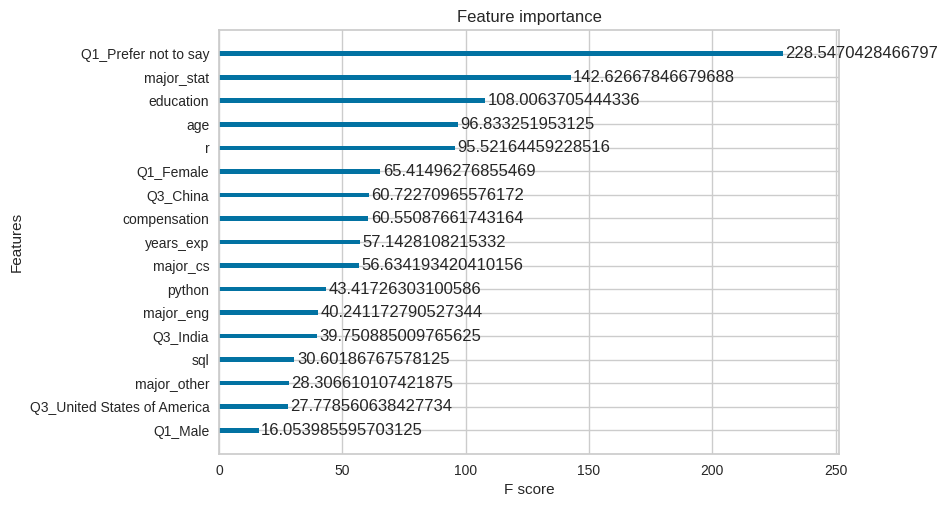

In [30]:
xgb.plot_importance(xgb_def, importance_type='cover')

<Axes: title={'center': 'Feature importance'}, xlabel='F score', ylabel='Features'>

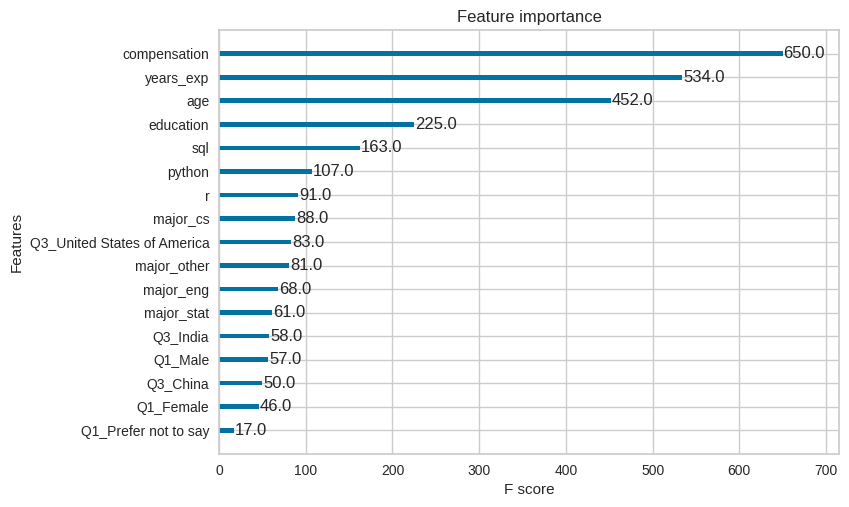

In [31]:
xgb.plot_importance(xgb_def, importance_type='weight')

## 17.4 Surrogate Models

In [37]:
sur_reg_sk = tree.DecisionTreeRegressor(max_depth=4)
sur_reg_sk.fit(X_train, xgb_def.predict_proba(X_train)[:,-1]) #

DecisionTreeRegressor(max_depth=4)

[Text(0.5, 0.9, 'x[5] <= 0.5\nsquared_error = 0.117\nsamples = 2110\nvalue = 0.454'),
 Text(0.25, 0.7, 'x[14] <= 0.5\nsquared_error = 0.1\nsamples = 1484\nvalue = 0.56'),
 Text(0.125, 0.5, 'x[11] <= 0.5\nsquared_error = 0.112\nsamples = 718\nvalue = 0.428'),
 Text(0.0625, 0.3, 'x[2] <= 2.5\nsquared_error = 0.083\nsamples = 322\nvalue = 0.563'),
 Text(0.03125, 0.1, 'squared_error = 0.073\nsamples = 193\nvalue = 0.471'),
 Text(0.09375, 0.1, 'squared_error = 0.066\nsamples = 129\nvalue = 0.702'),
 Text(0.1875, 0.3, 'x[2] <= 4.5\nsquared_error = 0.108\nsamples = 396\nvalue = 0.318'),
 Text(0.15625, 0.1, 'squared_error = 0.066\nsamples = 294\nvalue = 0.238'),
 Text(0.21875, 0.1, 'squared_error = 0.158\nsamples = 102\nvalue = 0.547'),
 Text(0.375, 0.5, 'x[2] <= 3.5\nsquared_error = 0.058\nsamples = 766\nvalue = 0.684'),
 Text(0.3125, 0.3, 'x[1] <= 17.0\nsquared_error = 0.05\nsamples = 525\nvalue = 0.628'),
 Text(0.28125, 0.1, 'squared_error = 0.04\nsamples = 258\nvalue = 0.693'),
 Text(0.343

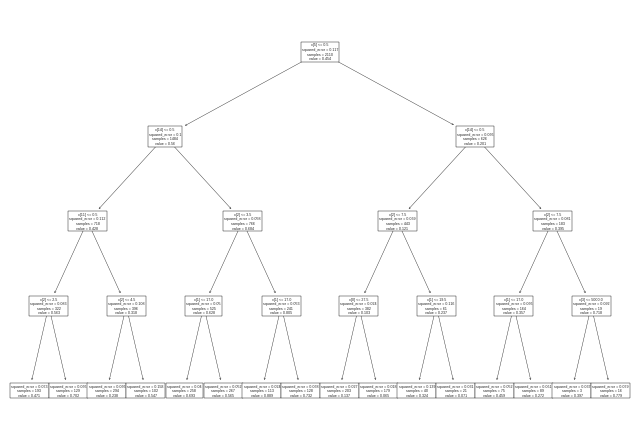

In [38]:
tree.plot_tree(sur_reg_sk)

## Regression Tree on a Constant Relationship

In [45]:
w = np.random.uniform(0,1, size=1000)
z = w.copy()
w = pd.DataFrame(w)
w = w.assign(constant=1)

In [49]:
w.to_numpy

<bound method DataFrame.to_numpy of             0  constant
0    0.132967         1
1    0.282515         1
2    0.647699         1
3    0.187749         1
4    0.742698         1
..        ...       ...
995  0.638305         1
996  0.249587         1
997  0.761299         1
998  0.768574         1
999  0.060898         1

[1000 rows x 2 columns]>

In [40]:
lin_tree = tree.DecisionTreeRegressor()

In [52]:
reg_tree = lin_tree.fit(w.to_numpy(),z)

[Text(0.486950618315508, 0.9642857142857143, 'x[0] <= 0.488\nsquared_error = 0.083\nsamples = 1000\nvalue = 0.5'),
 Text(0.23057737299465242, 0.8928571428571429, 'x[0] <= 0.232\nsquared_error = 0.02\nsamples = 477\nvalue = 0.238'),
 Text(0.11687834224598931, 0.8214285714285714, 'x[0] <= 0.11\nsquared_error = 0.004\nsamples = 226\nvalue = 0.108'),
 Text(0.05806595365418895, 0.75, 'x[0] <= 0.051\nsquared_error = 0.001\nsamples = 117\nvalue = 0.053'),
 Text(0.02749554367201426, 0.6785714285714286, 'x[0] <= 0.025\nsquared_error = 0.0\nsamples = 54\nvalue = 0.024'),
 Text(0.014081996434937611, 0.6071428571428571, 'x[0] <= 0.011\nsquared_error = 0.0\nsamples = 29\nvalue = 0.012'),
 Text(0.006595365418894831, 0.5357142857142857, 'x[0] <= 0.005\nsquared_error = 0.0\nsamples = 12\nvalue = 0.005'),
 Text(0.0035650623885918, 0.4642857142857143, 'x[0] <= 0.003\nsquared_error = 0.0\nsamples = 5\nvalue = 0.001'),
 Text(0.00285204991087344, 0.39285714285714285, 'x[0] <= 0.001\nsquared_error = 0.0\nsa

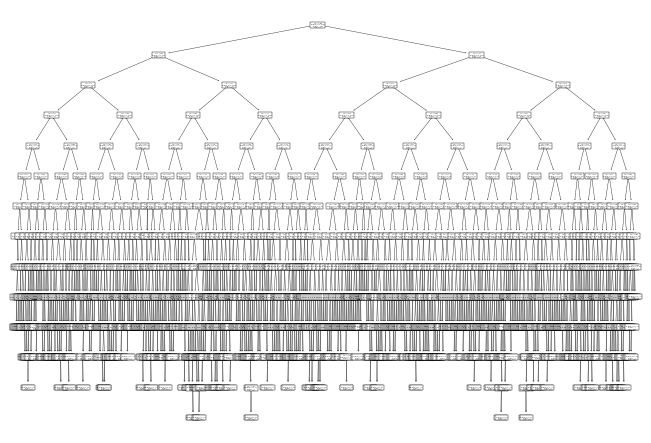

In [53]:
tree.plot_tree(reg_tree) #yeah, you see all these self-splits on it, and it is a perfectly linear relationship

In [54]:
fiz = dtreeviz.model(reg_tree, X_train = w.to_numpy(), y_train = z, feature_names = w.columns)
fiz.view(max_depth=3)


findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font family 'Arial' not found.
findfont: Font f